# Detectron Object Detection with OpenImages Dataset

## Dataset

Download the annotations for the detection boxes from [OpenImages](https://storage.googleapis.com/openimages/web/download_v7.html):

In [ ]:
!pip install opencv-python

In [ ]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

In [1]:
import ast
import json
import cv2 as cv
import matplotlib.pyplot as plt
import numpy as np
import os
import random
import shutil
import torch

from detectron2 import model_zoo
from detectron2.config import get_cfg as _get_cfg
from detectron2.data import MetadataCatalog, DatasetCatalog, build_detection_train_loader
from detectron2.engine import DefaultTrainer, HookBase, DefaultPredictor
from detectron2.structures import BoxMode
import detectron2.utils.comm as comm

In [5]:
!wget https://storage.googleapis.com/openimages/v6/oidv6-train-annotations-bbox.csv -P '../datasets/OpenImages/annotations'
!wget https://storage.googleapis.com/openimages/v5/validation-annotations-bbox.csv -P '../datasets/OpenImages/annotations'
!wget https://storage.googleapis.com/openimages/v5/test-annotations-bbox.csv -P '../datasets/OpenImages/annotations'

!wget https://raw.githubusercontent.com/openimages/dataset/master/downloader.py -P './helper'

--2023-09-02 15:26:06--  https://storage.googleapis.com/openimages/v5/test-annotations-bbox.csv
Loaded CA certificate '/etc/ssl/certs/ca-certificates.crt'
Resolving storage.googleapis.com (storage.googleapis.com)... 142.251.214.144, 172.217.164.112, 142.250.72.208, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.251.214.144|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 77484237 (74M) [text/csv]
Saving to: ‘../datasets/OpenImages/annotations/test-annotations-bbox.csv’

test-annotations-bb 100%[===================>]  73.89M  8.05MB/s    in 12s     

2023-09-02 15:26:19 (6.31 MB/s) - ‘../datasets/OpenImages/annotations/test-annotations-bbox.csv’ saved [77484237/77484237]



### Curate Dataset by Class

* Scripts by [computervisioneng](https://github.com/computervisioneng/train-yolov8-custom-dataset-step-by-step-guide/tree/master/prepare_data)
* Get class IDs from [here](https://gist.github.com/mpolinowski/7b297ad73545e0c670a248a2c350b011)

In [2]:
# Create a text file containing all the image IDs that you're interested in downloading.

class_id = '/m/01g317' # 'Person'
# class_id = '/m/0k4j' # 'Car'
# class_id = '/m/0h2r6' # 'Van'
# class_id = '/m/01bjv' # 'Bus'
# class_id = '/m/07r04' # 'Truck'
# class_id = '/m/01jfm_' # 'Vehicle registration plate'
# class_id = '/m/01lrl' # 'Carnivore'

train_bboxes_filename = '../datasets/OpenImages/annotations/oidv6-train-annotations-bbox.csv'
validation_bboxes_filename = '../datasets/OpenImages/annotations/validation-annotations-bbox.csv'
test_bboxes_filename = '../datasets/OpenImages/annotations/test-annotations-bbox.csv'

image_list_file_path = '../datasets/OpenImages/image_class_person.txt'
# image_list_file_path = '../datasets/OpenImages/image_class_car.txt'
# image_list_file_path = '../datasets/OpenImages/image_class_van.txt'
# image_list_file_path = '../datasets/OpenImages/image_class_bus.txt'
# image_list_file_path = '../datasets/OpenImages/image_class_truck.txt'
# image_list_file_path = '../datasets/OpenImages/image_class_plates.txt'
# image_list_file_path = '../datasets/OpenImages/image_class_carnivore.txt'

In [ ]:
image_list_file_list = []
for j, filename in enumerate([train_bboxes_filename, validation_bboxes_filename, test_bboxes_filename]):
    print(filename)
    with open(filename, 'r') as f:
        line = f.readline()
        while len(line) != 0:
            id, _, class_name, _, x1, x2, y1, y2, _, _, _, _, _ = line.split(',')[:13]
            if class_name in [class_id] and id not in image_list_file_list:
                image_list_file_list.append(id)
                with open(image_list_file_path, 'a') as fw:
                    fw.write('{}/{}\n'.format(['train', 'validation', 'test'][j], id))
            line = f.readline()

        f.close()

# the download returned 395931 images with class 'Person' -> I reduced them to 1% over all classes (3961) for this test run

In [24]:
# Run the following script to download all files, making sure you have the dependencies installed:

# !python helper/downloader.py --image_list='../datasets/OpenImages/image_class_person.txt' --download_folder='../datasets/OpenImages/complete' --num_processes=5
!python helper/downloader.py '../datasets/OpenImages/image_class_person_1%.txt' --download_folder='../datasets/OpenImages/complete' --num_processes=5

In [71]:
# get ids for all files from list that were used
file_ids = []

text_file = '../datasets/OpenImages/image_class_person_1%.txt'
files_list = open(text_file, 'r')

lines = files_list.readlines()

for line in lines:
    file_ids.append(line.strip()[-16:])

In [72]:
print(len(file_ids))

3961


In [53]:
for j, filename in enumerate([train_bboxes_filename, validation_bboxes_filename, test_bboxes_filename]):
    print(j, filename)

0 ../datasets/OpenImages/annotations/oidv6-train-annotations-bbox.csv
1 ../datasets/OpenImages/annotations/validation-annotations-bbox.csv
2 ../datasets/OpenImages/annotations/test-annotations-bbox.csv


In [73]:
# Train/Test/Split + generate YOLO compatible annotations
DATA_ALL_DIR = '../datasets/OpenImages/complete'
DATA_OUT_DIR = '../datasets/OpenImages/split'

# create directories
for set_ in ['train', 'validation', 'test']:
    for dir_ in [os.path.join(DATA_OUT_DIR, set_),
                 os.path.join(DATA_OUT_DIR, set_, 'imgs'),
                 os.path.join(DATA_OUT_DIR, set_, 'anns')]:
        if os.path.exists(dir_):
            shutil.rmtree(dir_)
        os.mkdir(dir_)

# save images and annotations
for j, filename in enumerate([train_bboxes_filename, validation_bboxes_filename, test_bboxes_filename]):
    set_ = ['train', 'validation', 'test'][j]
    print(filename)
    with open(filename, 'r') as f:
        line = f.readline()
        while len(line) != 0:
            # get bbox
            id, _, class_name, _, x1, x2, y1, y2, _, _, _, _, _ = line.split(',')[:13]
            # take all bboxes with the correct class
            if class_name in [class_id]:
                # but remove all that are not used (the example only uses 1% of all available images)
                if id in file_ids:
                    if not os.path.exists(os.path.join(DATA_OUT_DIR, set_, 'imgs', '{}.jpg'.format(id))):
                        shutil.copy(os.path.join(DATA_ALL_DIR, '{}.jpg'.format(id)),
                                    os.path.join(DATA_OUT_DIR, set_, 'imgs', '{}.jpg'.format(id)))
                    # yolo conform annotations
                    with open(os.path.join(DATA_OUT_DIR, set_, 'anns', '{}.txt'.format(id)), 'a') as f_ann:
                        # class_id, xc, yx, w, h
                        x1, x2, y1, y2 = [float(j) for j in [x1, x2, y1, y2]]
                        xc = (x1 + x2) / 2
                        yc = (y1 + y2) / 2
                        w = x2 - x1
                        h = y2 - y1
    
                        f_ann.write('0 {} {} {} {}\n'.format(xc, yc, w, h))
                        f_ann.close()

            line = f.readline()

../datasets/OpenImages/annotations/oidv6-train-annotations-bbox.csv
../datasets/OpenImages/annotations/validation-annotations-bbox.csv
../datasets/OpenImages/annotations/test-annotations-bbox.csv


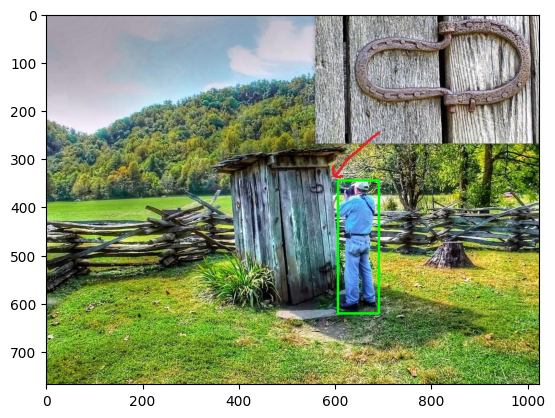

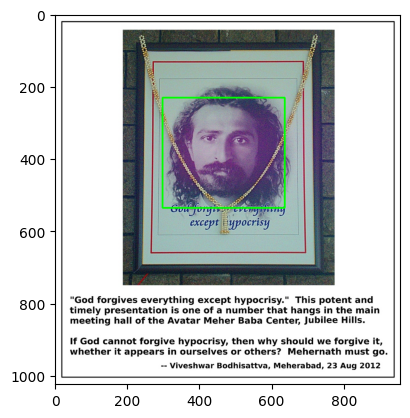

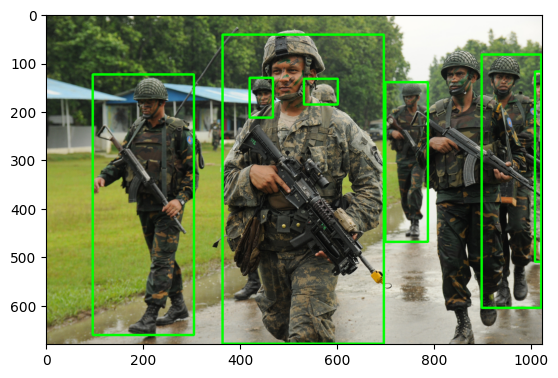

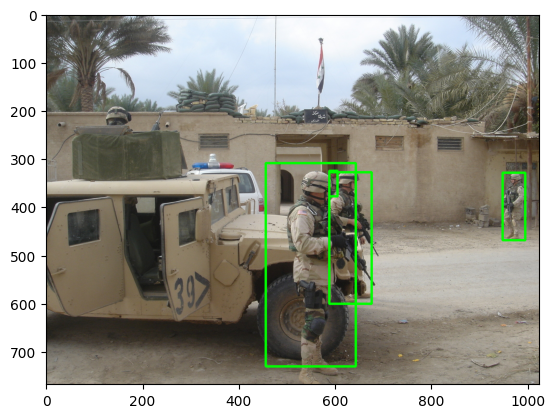

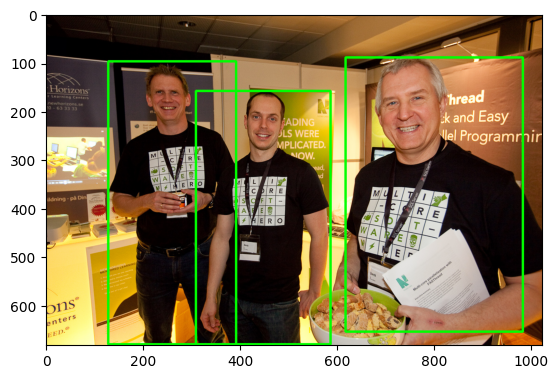

...

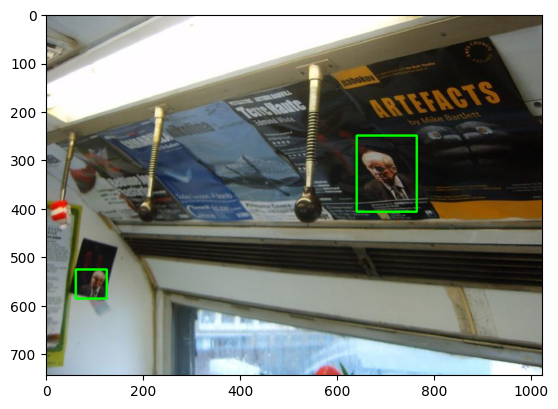

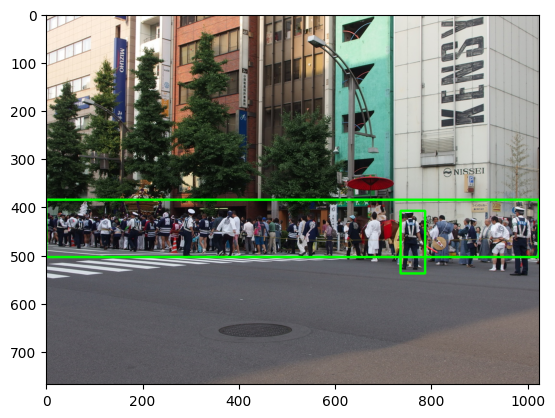

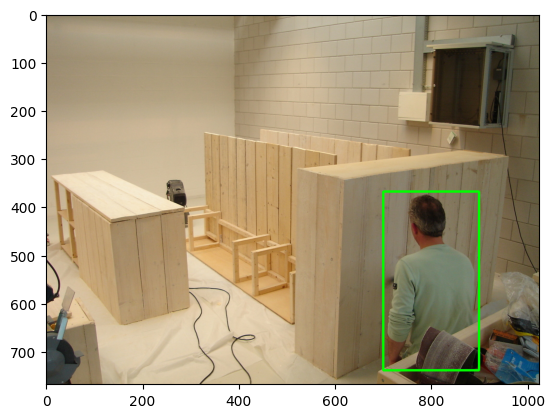

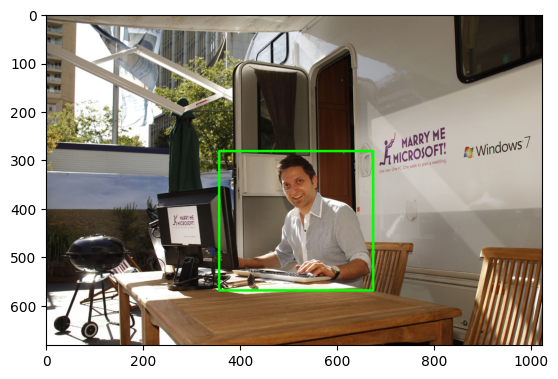

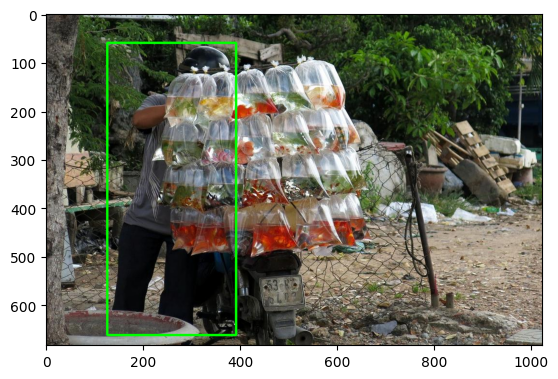

KeyboardInterrupt: 

In [26]:
IMGS_TRAIN_DIR = DATA_OUT_DIR + '/train/imgs'
ANNS_TRAIN_DIR = DATA_OUT_DIR + '/train/anns'

if __name__ == "__main__":
    files = os.listdir(IMGS_TRAIN_DIR)
    while True:
        fig = plt.figure()
        k = random.randint(0, len(files) - 1)
        img = cv.imread(os.path.join(IMGS_TRAIN_DIR, files[k]))
        ann_file = os.path.join(ANNS_TRAIN_DIR, files[k][:-4] + '.txt')

        h_img, w_img, _ = img.shape
        with open(ann_file, 'r') as f:
            lines = [l[:-1] for l in f.readlines() if len(l) > 2]
            for line in lines:
                line = line.split(' ')
                class_, x0, y0, w, h = line
                x1 = int((float(x0) - (float(w) / 2)) * w_img)
                y1 = int((float(y0) - (float(h) / 2)) * h_img)
                x2 = x1 + int(float(w) * w_img)
                y2 = y1 + int(float(h) * h_img)
                img = cv.rectangle(img,
                                    (x1, y1),
                                    (x2, y2),
                                    (0, 255, 0),
                                    4)
        mng = plt.get_current_fig_manager()
        plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
        plt.show()

## Model Training

In [2]:
# create loss function https://github.com/computervisioneng/train-object-detector-detectron2
class ValidationLoss(HookBase):
    """
    A hook that computes validation loss during training.

    Attributes:
        cfg (CfgNode): The detectron2 config node.
        _loader (iterator): An iterator over the validation dataset.
    """

    def __init__(self, cfg):
        """
        Args:
            cfg (CfgNode): The detectron2 config node.
        """
        super().__init__()
        self.cfg = cfg.clone()
        # Switch to the validation dataset
        self.cfg.DATASETS.TRAIN = cfg.DATASETS.VAL
        # Build the validation data loader iterator
        self._loader = iter(build_detection_train_loader(self.cfg))

    def after_step(self):
        """
        Computes the validation loss after each training step.
        """
        # Get the next batch of data from the validation data loader
        data = next(self._loader)
        with torch.no_grad():
            # Compute the validation loss on the current batch of data
            loss_dict = self.trainer.model(data)

            # Check for invalid losses
            losses = sum(loss_dict.values())
            assert torch.isfinite(losses).all(), loss_dict

            # Reduce the loss across all workers
            loss_dict_reduced = {"val_" + k: v.item() for k, v in
                                 comm.reduce_dict(loss_dict).items()}
            losses_reduced = sum(loss for loss in loss_dict_reduced.values())

            # Save the validation loss in the trainer storage
            if comm.is_main_process():
                self.trainer.storage.put_scalars(total_val_loss=losses_reduced,
                                                 **loss_dict_reduced)

In [3]:
# create detectron2 configuration https://github.com/computervisioneng/train-object-detector-detectron2
def get_cfg(output_dir, learning_rate, batch_size, iterations, checkpoint_period, model, device, nmr_classes):
    """
    Create a Detectron2 configuration object and set its attributes.

    Args:
        output_dir (str): The path to the output directory where the trained model and logs will be saved.
        learning_rate (float): The learning rate for the optimizer.
        batch_size (int): The batch size used during training.
        iterations (int): The maximum number of training iterations.
        checkpoint_period (int): The number of iterations between consecutive checkpoints.
        model (str): The name of the model to use, which should be one of the models available in Detectron2's model zoo.
        device (str): The device to use for training, which should be 'cpu' or 'cuda'.
        nmr_classes (int): The number of classes in the dataset.

    Returns:
        The Detectron2 configuration object.
    """
    cfg = _get_cfg()

    # Merge the model's default configuration file with the default Detectron2 configuration file.
    cfg.merge_from_file(model_zoo.get_config_file(model))
    # Set the training and validation datasets and exclude the test dataset.
    cfg.DATASETS.TRAIN = ('train')
    cfg.DATASETS.VAL = ('validation')
    cfg.DATASETS.TEST = ()
    # Set the device to use for training.
    if device in ['cpu']:
        cfg.MODEL.DEVICE = 'cpu'
    # Set the number of data loader workers.
    cfg.DATALOADER.NUM_WORKERS = 2
    # Set the model weights to the ones pre-trained on the COCO dataset.
    cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(model)
    # Set the batch size used by the solver.
    cfg.SOLVER.IMS_PER_BATCH = batch_size
    # Set the checkpoint period.
    cfg.SOLVER.CHECKPOINT_PERIOD = checkpoint_period
    # Set the base learning rate.
    cfg.SOLVER.BASE_LR = learning_rate
    # Set the maximum number of training iterations.
    cfg.SOLVER.MAX_ITER = iterations
    # Set the learning rate scheduler steps to an empty list, which means the learning rate will not be decayed.
    cfg.SOLVER.STEPS = []
    # Set the batch size used by the ROI heads during training.
    cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
    # Set the number of classes.
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = nmr_classes
    # Set the output directory.
    cfg.OUTPUT_DIR = output_dir
    
    return cfg

In [4]:
# get dataset https://github.com/computervisioneng/train-object-detector-detectron2
def get_dicts(img_dir, ann_dir):
    """
    Read the annotations for the dataset in YOLO format and create a list of dictionaries containing information for each
    image.

    Args:
        img_dir (str): Directory containing the images.
        ann_dir (str): Directory containing the annotations.

    Returns:
        list[dict]: A list of dictionaries containing information for each image. Each dictionary has the following keys:
            - file_name: The path to the image file.
            - image_id: The unique identifier for the image.
            - height: The height of the image in pixels.
            - width: The width of the image in pixels.
            - annotations: A list of dictionaries, one for each object in the image, containing the following keys:
                - bbox: A list of four integers [x0, y0, w, h] representing the bounding box of the object in the image,
                        where (x0, y0) is the top-left corner and (w, h) are the width and height of the bounding box,
                        respectively.
                - bbox_mode: A constant from the `BoxMode` class indicating the format of the bounding box coordinates
                             (e.g., `BoxMode.XYWH_ABS` for absolute coordinates in the format [x0, y0, w, h]).
                - category_id: The integer ID of the object's class.
    """
    dataset_dicts = []
    for idx, file in enumerate(os.listdir(ann_dir)):
        # annotations should be provided in yolo format

        record = {}

        filename = os.path.join(img_dir, file[:-4] + '.jpg')
        height, width = cv.imread(filename).shape[:2]

        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        objs = []
        with open(os.path.join(ann_dir, file)) as r:
            lines = [l[:-1] for l in r.readlines()]

        for _, line in enumerate(lines):
            if len(line) > 2:
                label, cx, cy, w_, h_ = line.split(' ')

                obj = {
                    "bbox": [int((float(cx) - (float(w_) / 2)) * width),
                             int((float(cy) - (float(h_) / 2)) * height),
                             int(float(w_) * width),
                             int(float(h_) * height)],
                    "bbox_mode": BoxMode.XYWH_ABS,
                    "category_id": int(label),
                }

                objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

In [5]:
# register dataset https://github.com/computervisioneng/train-object-detector-detectron2
def register_datasets(root_dir, class_list_file):
    """
    Registers the train and validation datasets and returns the number of classes.

    Args:
        root_dir (str): Path to the root directory of the dataset.
        class_list_file (str): Path to the file containing the list of class names.

    Returns:
        int: The number of classes in the dataset.
    """
    # Read the list of class names from the class list file.
    with open(class_list_file, 'r') as reader:
        classes_ = [l[:-1] for l in reader.readlines()]

    # Register the train and validation datasets.
    for d in ['train', 'validation']:
        DatasetCatalog.register(d, lambda d=d: get_dicts(os.path.join(root_dir, d, 'imgs'),
                                                         os.path.join(root_dir, d, 'anns')))
        # Set the metadata for the dataset.
        MetadataCatalog.get(d).set(thing_classes=classes_)

    return len(classes_)

In [6]:
# train the dataset
def train(output_dir, data_dir, class_list_file, learning_rate, batch_size, iterations, checkpoint_period, device,
          model):
    """
    Train a Detectron2 model on a custom dataset.

    Args:
        output_dir (str): Path to the directory to save the trained model and output files.
        data_dir (str): Path to the directory containing the dataset.
        class_list_file (str): Path to the file containing the list of class names in the dataset.
        learning_rate (float): Learning rate for the optimizer.
        batch_size (int): Batch size for training.
        iterations (int): Maximum number of training iterations.
        checkpoint_period (int): Number of iterations after which to save a checkpoint of the model.
        device (str): Device to use for training (e.g., 'cpu' or 'cuda').
        model (str): Name of the model configuration to use. Must be a key in the Detectron2 model zoo.

    Returns:
        None
    """

    # Register the dataset and get the number of classes
    nmr_classes = register_datasets(data_dir, class_list_file)

    # Get the configuration for the model
    cfg = get_cfg(output_dir, learning_rate, batch_size, iterations, checkpoint_period, model, device, nmr_classes)

    # Create the output directory
    os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

    # Create the trainer object
    trainer = DefaultTrainer(cfg)

    # Create a custom validation loss object
    val_loss = ValidationLoss(cfg)

    # Register the custom validation loss object as a hook to the trainer
    trainer.register_hooks([val_loss])

    # Swap the positions of the evaluation and checkpointing hooks so that the validation loss is logged correctly
    trainer._hooks = trainer._hooks[:-2] + trainer._hooks[-2:][::-1]

    # Resume training from a checkpoint or load the initial model weights
    trainer.resume_or_load(resume=False)

    # Train the model
    trainer.train()

In [7]:
CLASSES = '../datasets/OpenImages/class_names.txt' # add classes to this file - 1 per line
DATA_DIR = '../datasets/OpenImages/split' # point to dir that contains your train/validation/test folders
OUTPUT_DIR = '../saved_models/OpenImages_Model' # weight will be saved here at interval set below
DEVICE = 'gpu' # 'cpu'
LR = 0.00001
BATCH_SIZE = 4
ITERATIONS = 12000 # how many epochs do you want to train?
CHECKPOINT_PERIOD = 3000 # save weights at this epoch interval
# MODEL= 'COCO-Detection/fast_rcnn_R_50_FPN_1x.yaml' # 2.6 GB Train Mem
MODEL= 'COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml' # 3.0 GB Train Mem
# MODEL= 'COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml' # 4.1 GB Train Mem
# MODEL = 'COCO-Detection/retinanet_R_101_FPN_3x.yaml' # 5.2 GB Train Mem

In [8]:
train(
    OUTPUT_DIR,
    DATA_DIR,
    CLASSES,
    device=DEVICE,
    learning_rate=float(LR),
    batch_size=int(BATCH_SIZE),
    iterations=int(ITERATIONS),
    checkpoint_period=int(CHECKPOINT_PERIOD),
    model=MODEL)

[09/03 16:20:19 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:21, 7.86MB/s]                                                                                                        
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Some m

[09/03 16:21:15 d2.engine.train_loop]: Starting training from iteration 0


/opt/conda/lib/python3.10/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1682343967769/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[09/03 16:21:50 d2.utils.events]:  eta: 3:48:37  iter: 19  total_loss: 1.462  loss_cls: 0.7677  loss_box_reg: 0.6704  loss_rpn_cls: 0.02752  loss_rpn_loc: 0.01631  total_val_loss: 1.484  val_loss_cls: 0.758  val_loss_box_reg: 0.6438  val_loss_rpn_cls: 0.04108  val_loss_rpn_loc: 0.02314    time: 1.1673  last_time: 1.2591  data_time: 0.0410  last_data_time: 0.0075   lr: 1.9981e-07  max_mem: 4713M
[09/03 16:22:26 d2.utils.events]:  eta: 4:05:42  iter: 39  total_loss: 1.52  loss_cls: 0.7554  loss_box_reg: 0.6884  loss_rpn_cls: 0.04201  loss_rpn_loc: 0.02074  total_val_loss: 1.337  val_loss_cls: 0.7517  val_loss_box_reg: 0.5342  val_loss_rpn_cls: 0.04219  val_loss_rpn_loc: 0.01974    time: 1.2224  last_time: 1.5055  data_time: 0.0201  last_data_time: 0.0028   lr: 3.9961e-07  max_mem: 4713M
[09/03 16:23:02 d2.utils.events]:  eta: 4:13:45  iter: 59  total_loss: 1.537  loss_cls: 0.7535  loss_box_reg: 0.6921  loss_rpn_cls: 0.04213  loss_rpn_loc: 0.02889  total_val_loss: 1.391  val_loss_cls: 0.7

## Model Evaluation

Visualizing the `metrics.json` file generated in your above defined output dir:

In [9]:
def moving_average(a, n=3):
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n


metrics_file = OUTPUT_DIR + '/metrics.json'

with open(metrics_file, 'r') as f:
    metrics = [ast.literal_eval(l[:-1]) for l in f.readlines()]
    f.close()

train_loss = [float(v['loss_box_reg']) for v in metrics if 'loss_box_reg' in v.keys()]
val_loss = [float(v['val_loss_box_reg']) for v in metrics if 'val_loss_box_reg' in v.keys()]

N = 40

train_loss_avg = moving_average(train_loss, n=N)
val_loss_avg = moving_average(val_loss, n=N)

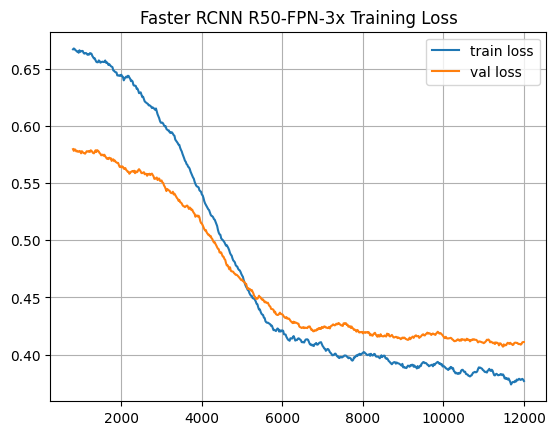

In [11]:
plt.plot(range(20 * N - 1, 20 * len(train_loss), 20), train_loss_avg, label='train loss')
plt.plot(range(20 * N - 1, 20 * len(train_loss), 20), val_loss_avg, label='val loss')
plt.title('Faster RCNN R50-FPN-3x Training Loss')
plt.legend()
plt.grid()
plt.show()

## Model Predictions

In [ ]:
# Load config from a config file
cfg = _get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(MODEL))
cfg.MODEL.WEIGHTS = OUTPUT_DIR + '/model_0011999.pth'
cfg.MODEL.DEVICE = 'cuda'

In [ ]:
# Create predictor instance
predictor = DefaultPredictor(cfg)

# Load image
image = cv.imread(OUTPUT_DIR + "/sz.jpg")

# Perform prediction
outputs = predictor(image)

In [ ]:
outputs

In [14]:
# Display predictions
threshold = 0.5

preds = outputs["instances"].pred_classes.tolist()
scores = outputs["instances"].scores.tolist()
bboxes = outputs["instances"].pred_boxes

In [ ]:
for j, bbox in enumerate(bboxes):
    bbox = bbox.tolist()

    score = scores[j]
    pred = preds[j]

    if score > threshold:
        x1, y1, x2, y2 = [int(i) for i in bbox]

        cv.rectangle(image, (x1, y1), (x2, y2), (0, 0, 255), 5)

cv.imshow('image', image)
cv.waitKey(0)